# Pancreatic endocrinogenesis

This tutorial uses raw data from [scvelo](https://github.com/theislab/scvelo) package. Special thanks go to the scvelo team! 

In [ ]:
# get the latest version from pypi 
# for other installations approaches, see https://dynamo-release.readthedocs.io/en/latest/ten_minutes_to_dynamo.html#how-to-install
!pip install dynamo-release --upgrade --quiet

In [1]:
# from IPython.core.display import display, HTML
# display(HTML("<style>.container { width:90% !important; }</style>"))
# %matplotlib inline
import warnings
warnings.filterwarnings('ignore')

import dynamo as dyn 

this is like R's sessionInfo()

In [2]:
dyn.get_all_dependencies_version()

package,dynamo-release,pre-commit,cvxopt,trimap,numdifftools,colorcet,python-igraph,pynndescent,hdbscan,loompy,matplotlib,networkx,numba,numpy,pandas,scikit-learn,scipy,seaborn,setuptools,statsmodels,tqdm,umap-learn
version,1.0.0,2.11.1,1.2.6,1.4.3.dev1,0.9.39,2.0.6,0.9.0,0.5.2,0.8.27,3.0.6,3.4.1,2.5.1,0.53.1,1.20.3,1.2.3,0.23.2,1.6.1,0.11.1,54.2.0,0.12.2,4.58.0,0.5.1


|-----> Downloading data to ./data/endocrinogenesis_day15.h5ad
|-----> apply Monocole recipe to adata...
|-----> <insert> pp to uns in AnnData Object.
|-----------> <insert> has_splicing to uns['pp'] in AnnData Object.
|-----------> <insert> has_labling to uns['pp'] in AnnData Object.
|-----------> <insert> splicing_labeling to uns['pp'] in AnnData Object.
|-----------> <insert> has_protein to uns['pp'] in AnnData Object.
|-----> ensure all cell and variable names unique.
|-----> ensure all data in different layers in csr sparse matrix format.
|-----> ensure all labeling data properly collapased
|-----------> <insert> tkey to uns['pp'] in AnnData Object.
|-----------> <insert> experiment_type to uns['pp'] in AnnData Object.
|-----> filtering cells...
|-----> filtering genes...
|-----> calculating size factor...
|-----> selecting genes...
|-----> <insert> frac to var in AnnData Object.
|-----> size factor normalizing the data, followed by log1p transformation.
|-----> applying PCA ...
|

<Figure size 600x400 with 0 Axes>

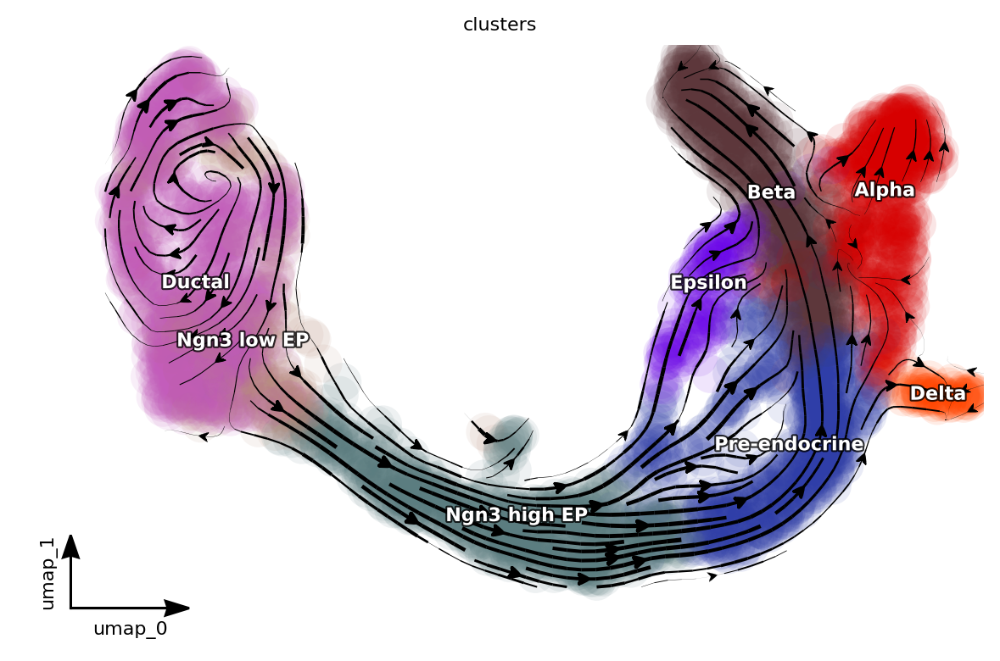

In [3]:
# run dynamo to get RNA velocity 

dyn.configuration.set_figure_params('dynamo', background='white')

adata = dyn.sample_data.pancreatic_endocrinogenesis()

dyn.pp.recipe_monocle(adata, n_top_genes=1000, fg_kwargs={'shared_count': 20})

dyn.tl.dynamics(adata, model='stochastic')

dyn.tl.reduceDimension(adata, n_pca_components=30)

dyn.tl.cell_velocities(adata, method='pearson', other_kernels_dict={'transform': 'sqrt'})
dyn.pl.streamline_plot(adata, color=['clusters'], basis='umap', show_legend='on data', show_arrowed_spines=True)


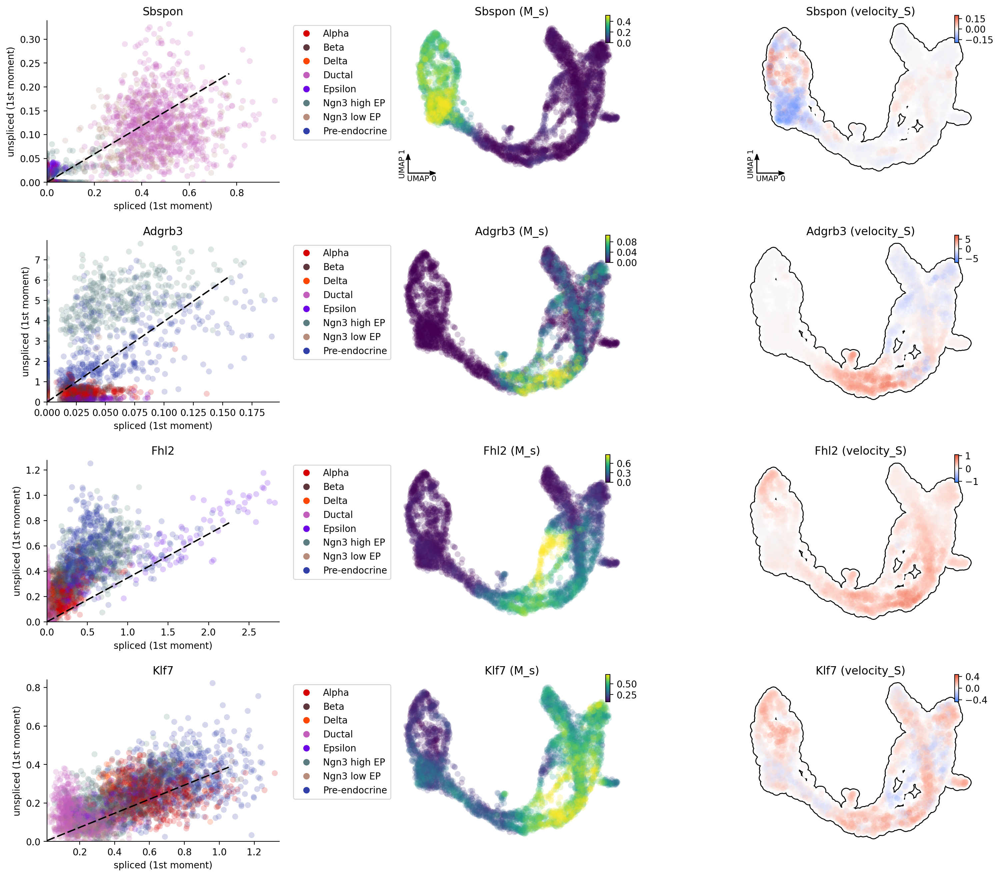

In [4]:
dyn.pl.phase_portraits(adata, genes=adata.var_names[adata.var.use_for_dynamics][:4], figsize=(6, 4), color='clusters')

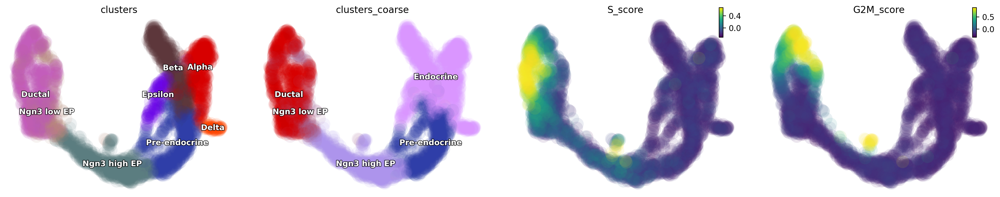

In [5]:
dyn.pl.umap(adata, color=['clusters', 'clusters_coarse', "S_score", "G2M_score"], ncols=4, alpha=0.1)

<Figure size 600x400 with 0 Axes>

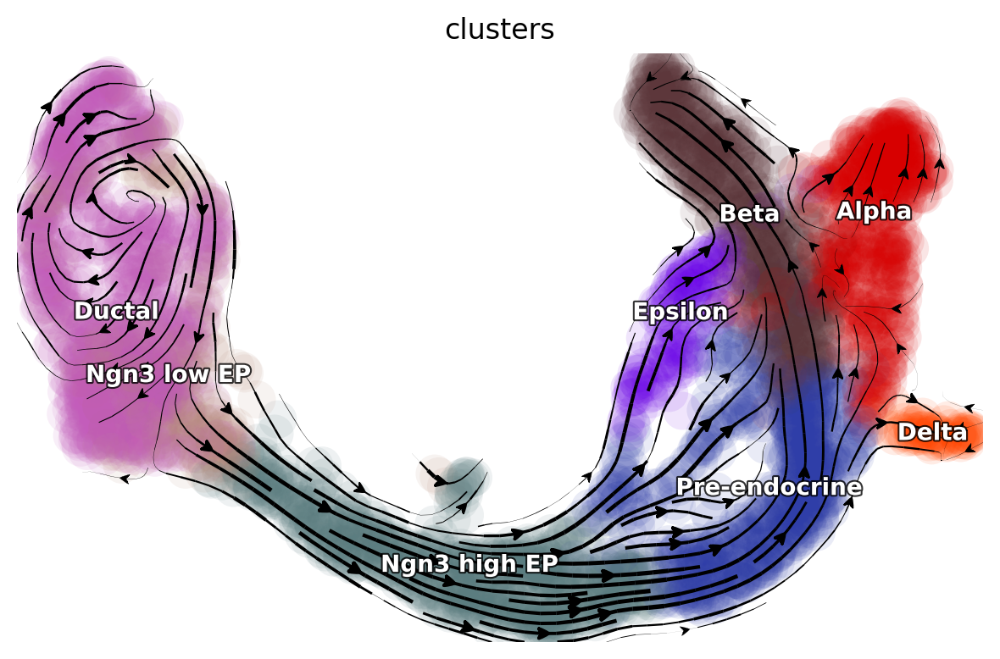

In [6]:
dyn.pl.streamline_plot(adata, color=['clusters'], basis='umap', show_legend='on data')


<Figure size 800x600 with 0 Axes>

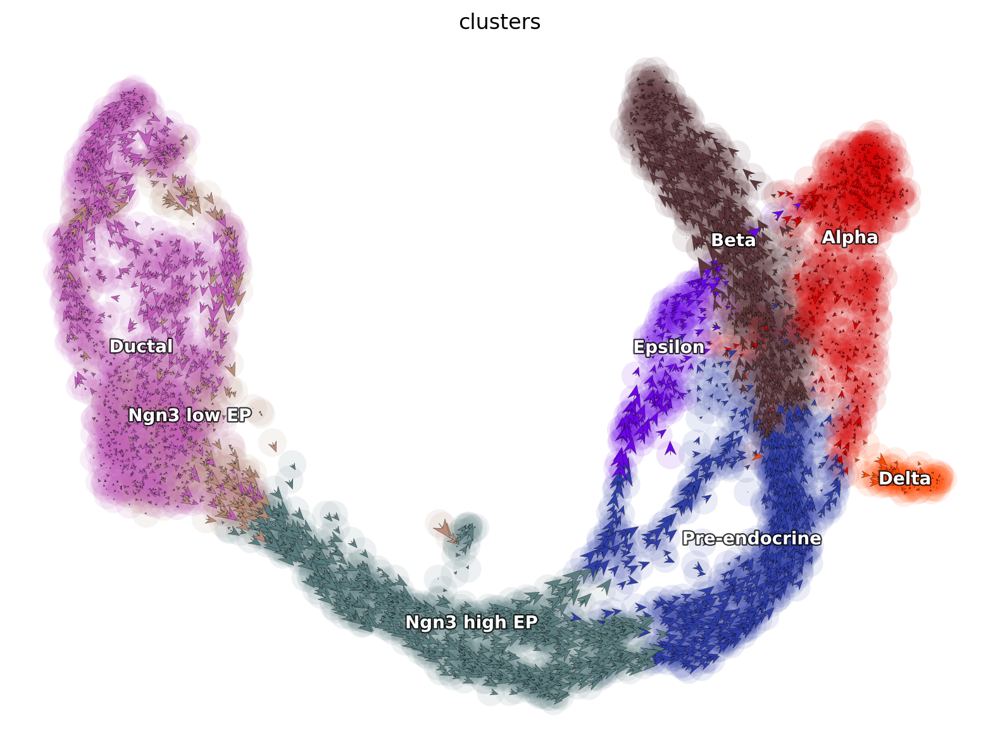

In [7]:
dyn.pl.cell_wise_vectors(adata, color=['clusters'], basis='umap', show_legend='on data', quiver_length=6, quiver_size=6, figsize=(8, 6), show_arrowed_spines=False)


In [8]:
# ok some exciting vector field analysis 

# you can set `verbose = 1/2/3` to obtain different levels of running information of vector field reconstruction

dyn.vf.VectorField(adata, basis='umap', pot_curl_div=True) # , M=1000, MaxIter=1000


|-----> vectorfield calculation begins...
|-----> Retrieve X and V based on basis: UMAP. 
        Vector field will be learned in the UMAP space.
|-----> Generating high dimensional grids and convert into a row matrix.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] in progress: 100.0000%
|-----> [SparseVFC] finished [27.0002s]
|-----------> current cosine correlation between input velocities and learned velocities is less than 0.6. Make a 1-th vector field reconstruction trial.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] in progress: 100.0000%
|-----> [SparseVFC] finished [28.0645s]
|-----------> current cosine correlation between input velocities and learned velocities is less than 0.6. Make a 2-th vector field reconstruction trial.
|-----> [SparseVFC] begins...
|-----> Sampling control po

|-----> Vector field for umap is but its topography is not mapped. Mapping topography now ...


<Figure size 600x400 with 0 Axes>

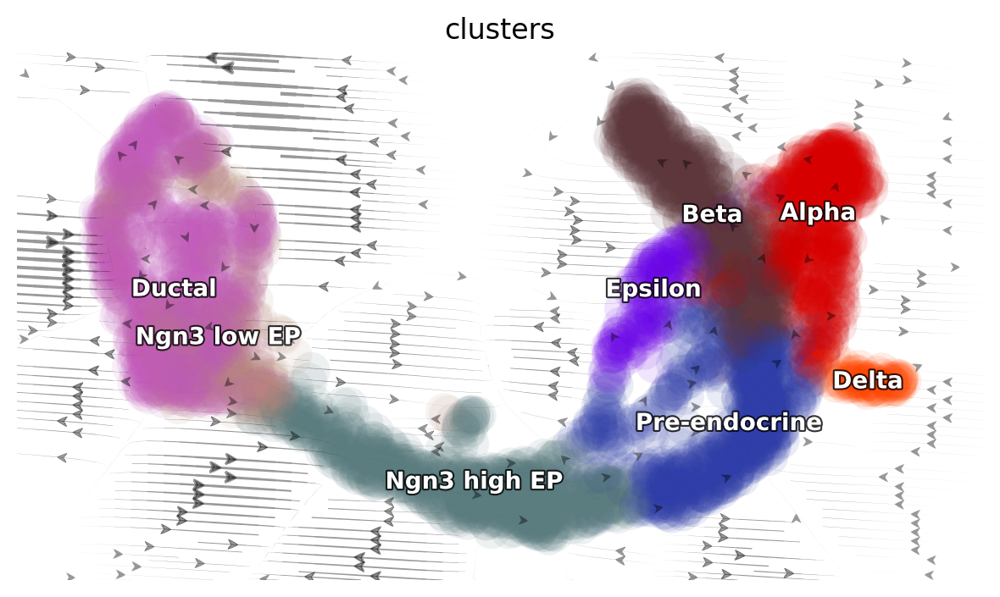

In [9]:
dyn.pl.topography(adata, color=['clusters'], basis='umap', background='white', 
                  streamline_color='black', show_legend='on data', terms=("streamline"))


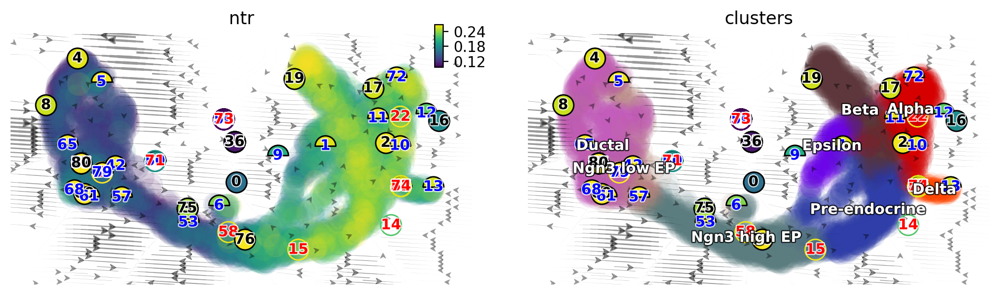

In [10]:
dyn.pl.topography(adata, basis='umap', background='white', color=['ntr', 'clusters'], streamline_color='black', show_legend='on data')


In [11]:
dyn.tl.cell_velocities(adata, basis='pca')
dyn.vf.VectorField(adata, basis='pca')
dyn.vf.speed(adata)
dyn.vf.divergence(adata)
dyn.vf.acceleration(adata)
dyn.vf.curl(adata)

|-----> [projecting velocity vector to low dimensional embedding] in progress: 15.0162%

Using existing pearson_transition_matrix found in .obsp.


|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%
|-----> [projecting velocity vector to low dimensional embedding] finished [1.3292s]
|-----> vectorfield calculation begins...
|-----> Retrieve X and V based on basis: PCA. 
        Vector field will be learned in the PCA space.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] in progress: 100.0000%
|-----> [SparseVFC] finished [4.7452s]
|-----> <insert> velocity_pca_SparseVFC to obsm in AnnData Object.
|-----> <insert> X_pca_SparseVFC to obsm in AnnData Object.
|-----> <insert> VecFld_pca to uns in AnnData Object.
|-----> <insert> control_point_pca to obs in AnnData Object.
|-----> <insert> inlier_prob_pca to obs in AnnData Object.
|-----> <insert> obs_vf_angle_pca to obs in AnnData Object.
|-----> [VectorField] in progress: 100.0000%
|-----> [VectorField] finished [4.9270s]
C

In [12]:
adata

AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'Size_Factor', 'initial_cell_size', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'umap_ddhodge_div', 'umap_ddhodge_potential', 'curl_umap', 'divergence_umap', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca', 'speed_umap', 'divergence_pca', 'acceleration_umap'
    var: 'highly_variable_genes', 'nCells', 'nCounts', 'pass_basic_filter', 'log_m', 'log_cv', 'score', 'use_for_pca', 'frac', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors'

this just shows how flexible dynamo' plotting function can be. 

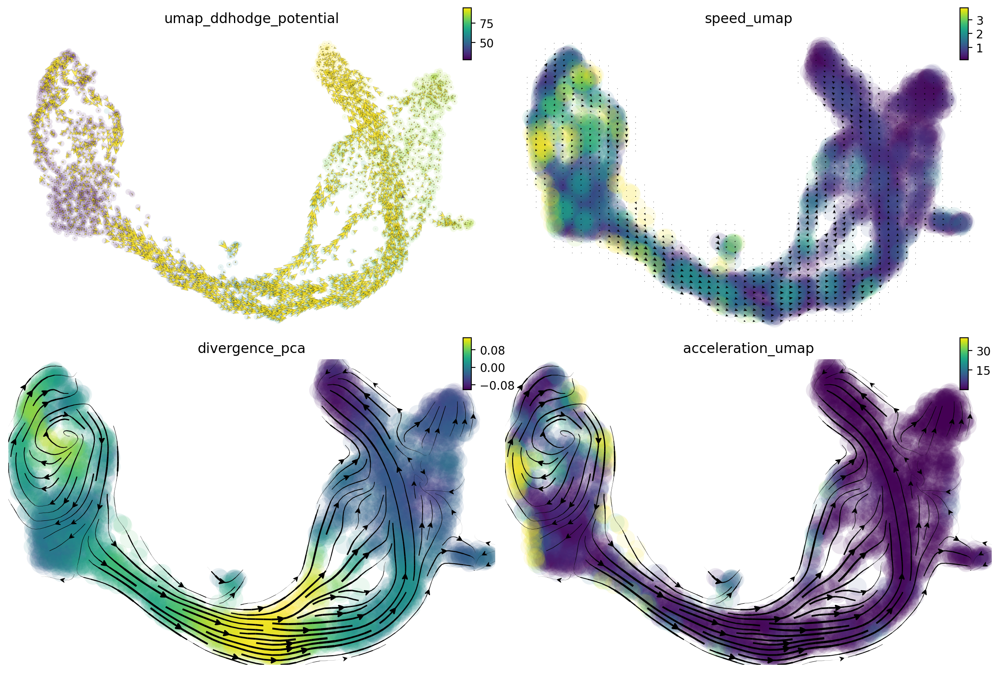

In [13]:
import matplotlib.pyplot as plt
fig1, f1_axes = plt.subplots(ncols=2, nrows=2, constrained_layout=True, figsize=(12, 8))
f1_axes
f1_axes[0, 0] = dyn.pl.cell_wise_vectors(adata, color='umap_ddhodge_potential', pointsize=0.1, alpha = 0.7, ax=f1_axes[0, 0], quiver_length=6, quiver_size=6, save_show_or_return='return')
f1_axes[0, 1] = dyn.pl.grid_vectors(adata, color='speed_umap', ax=f1_axes[0, 1], quiver_length=12, quiver_size=12, save_show_or_return='return')
f1_axes[1, 0] = dyn.pl.streamline_plot(adata, color='divergence_pca', ax=f1_axes[1, 0], save_show_or_return='return')
f1_axes[1, 1] = dyn.pl.streamline_plot(adata, color='acceleration_umap', ax=f1_axes[1, 1], save_show_or_return='return')
plt.show()

In [14]:
# emulate ggplot2 plotting styple with black background
dyn.configuration.set_figure_params('dynamo', background='black')  

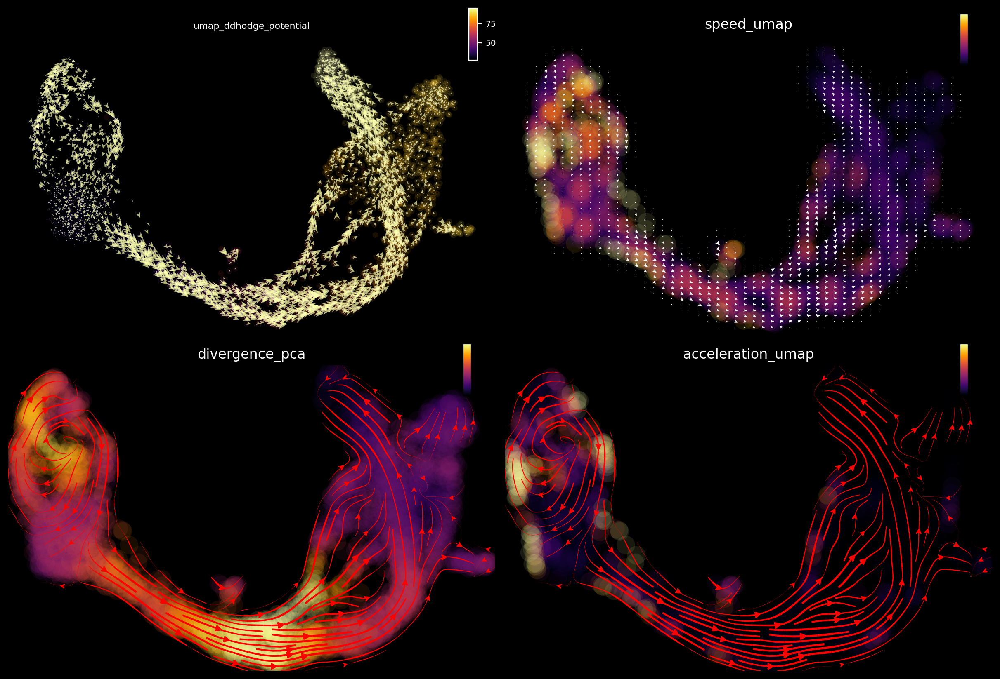

In [15]:
fig1, f1_axes = plt.subplots(ncols=2, nrows=2, constrained_layout=True, figsize=(12, 8))
f1_axes
f1_axes[0, 0] = dyn.pl.cell_wise_vectors(adata, color='umap_ddhodge_potential', pointsize=0.1, alpha = 0.7, ax=f1_axes[0, 0], quiver_length=6, quiver_size=6, save_show_or_return='return', background='black')
f1_axes[0, 1] = dyn.pl.grid_vectors(adata, color='speed_umap', ax=f1_axes[0, 1], quiver_length=12, quiver_size=12, save_show_or_return='return', background='black')
f1_axes[1, 0] = dyn.pl.streamline_plot(adata, color='divergence_pca', ax=f1_axes[1, 0], save_show_or_return='return', background='black')
f1_axes[1, 1] = dyn.pl.streamline_plot(adata, color='acceleration_umap', ax=f1_axes[1, 1], save_show_or_return='return', background='black')
plt.show()

In [16]:
dyn.tl.cell_velocities(adata, basis='pca')
dyn.vf.VectorField(adata, basis='pca', pot_curl_div=True)


|-----> [projecting velocity vector to low dimensional embedding] in progress: 14.0152%

Using existing pearson_transition_matrix found in .obsp.


|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%
|-----> [projecting velocity vector to low dimensional embedding] finished [1.4030s]
|-----> vectorfield calculation begins...
|-----> Retrieve X and V based on basis: PCA. 
        Vector field will be learned in the PCA space.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] in progress: 100.0000%
|-----> [SparseVFC] finished [4.6329s]
|-----> <insert> velocity_pca_SparseVFC to obsm in AnnData Object.
|-----> <insert> X_pca_SparseVFC to obsm in AnnData Object.
|-----> <insert> VecFld_pca to uns in AnnData Object.
|-----> Running ddhodge to estimate vector field based pseudotime in pca basis...
|-----> [graphize_vecfld] in progress: 100.0000%
|-----> [graphize_vecfld] finished [69.1324s]
|-----> Computing divergence...
Calculating divergence: 100%|██████████| 3696/3696 [00:00<

In [17]:
dyn.vf.VectorField(adata, basis='umap', dims=[0, 1], M=adata.n_obs)


|-----> vectorfield calculation begins...
|-----> Retrieve X and V based on basis: UMAP. 
        Vector field will be learned in the UMAP space.
|-----> Generating high dimensional grids and convert into a row matrix.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] in progress: 100.0000%
|-----> [SparseVFC] finished [245.1133s]
|-----> <insert> velocity_umap_SparseVFC to obsm in AnnData Object.
|-----> <insert> X_umap_SparseVFC to obsm in AnnData Object.
|-----> <insert> VecFld_umap to uns in AnnData Object.
|-----> <insert> control_point_umap to obs in AnnData Object.
|-----> <insert> inlier_prob_umap to obs in AnnData Object.
|-----> <insert> obs_vf_angle_umap to obs in AnnData Object.
|-----> [VectorField] in progress: 100.0000%
|-----> [VectorField] finished [245.5379s]


|-----> Vector field for umap is but its topography is not mapped. Mapping topography now ...


<Figure size 600x400 with 0 Axes>

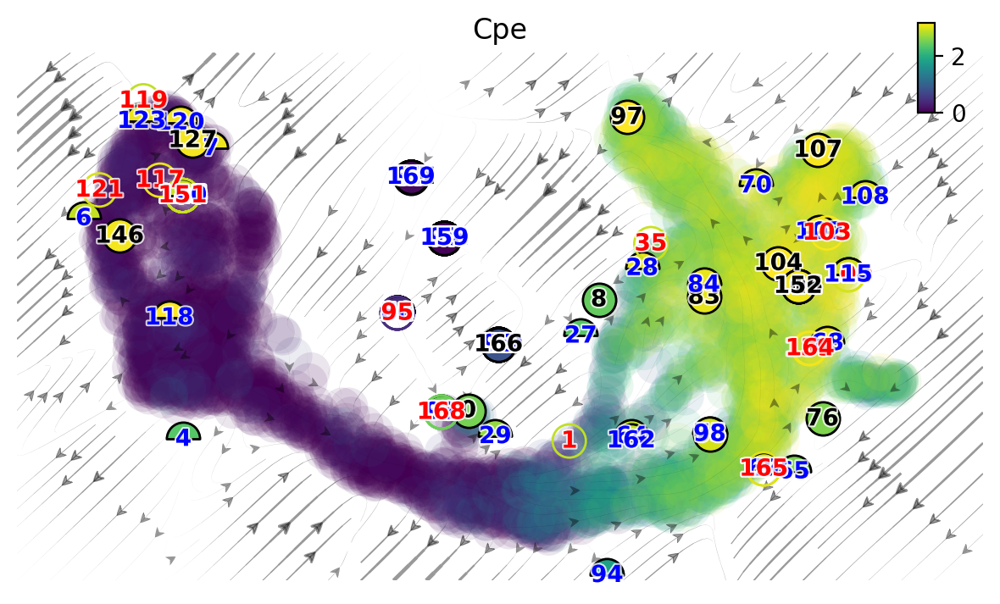

In [18]:
dyn.pl.topography(adata, color=['Cpe'], basis='umap')

In [19]:
dyn.pl.streamline_plot(adata, color=['Cpe'], basis='umap', show_legend='on data',  background='white',
                        show_arrowed_spines=False, save_show_or_return='save',
                        pointsize=0.4, ncols=1, alpha = 0.7, 
                       save_kwargs={'prefix': 'pancreas_streamline', 'ext': 'png',
                                     "bbox_inches": None}, 
                        figsize=(3, 3))

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/pancreas_streamline_dyn_savefig.png...
Done


<Figure size 300x300 with 0 Axes>

In [20]:
dyn.pl.phase_portraits(adata, genes=['Cpe'], basis='umap',
                       show_quiver=True,
                       background='white',
                        show_arrowed_spines=False, save_show_or_return='save',
                        pointsize=0.4, alpha = 0.7, quiver_length=10, quiver_size=6, 
                       save_kwargs={'prefix': 'pancreas_phase_portrait', 'ext': 'png',
                                     "bbox_inches": None}, 
                        figsize=(6, 4))

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/pancreas_phase_portrait_dyn_savefig.png...
Done


In [21]:
dyn.pl.topography(adata, color=['Cpe'], basis='umap', show_legend='on data',  background='white',
                        show_arrowed_spines=False, save_show_or_return='save',
                        pointsize=0.4, ncols=1, alpha = 0.7, 
                       save_kwargs={'prefix': 'pancreas_topography', 'ext': 'png',
                                     "bbox_inches": None}, 
                        figsize=(3, 3))

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/pancreas_topography_dyn_savefig.png...
Done


<Figure size 300x300 with 0 Axes>

In [22]:
dyn.tl.cell_velocities(adata, basis='pca')
dyn.vf.VectorField(adata, basis='pca', M=adata.n_obs, pot_curl_div=True)


|-----> [projecting velocity vector to low dimensional embedding] in progress: 15.0162%

Using existing pearson_transition_matrix found in .obsp.


|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%
|-----> [projecting velocity vector to low dimensional embedding] finished [1.3128s]
|-----> vectorfield calculation begins...
|-----> Retrieve X and V based on basis: PCA. 
        Vector field will be learned in the PCA space.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] in progress: 100.0000%
|-----> [SparseVFC] finished [50.1520s]
|-----> <insert> velocity_pca_SparseVFC to obsm in AnnData Object.
|-----> <insert> X_pca_SparseVFC to obsm in AnnData Object.
|-----> <insert> VecFld_pca to uns in AnnData Object.
|-----> Running ddhodge to estimate vector field based pseudotime in pca basis...
|-----> Computing divergence...
Calculating divergence: 100%|██████████| 3696/3696 [00:07<00:00, 465.54it/s]
|-----> <insert> control_point_pca to obs in AnnData Object.
|-----> <inser

In [23]:
adata

AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'Size_Factor', 'initial_cell_size', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'umap_ddhodge_div', 'umap_ddhodge_potential', 'curl_umap', 'divergence_umap', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca', 'speed_umap', 'divergence_pca', 'acceleration_umap', 'pca_ddhodge_div', 'pca_ddhodge_potential'
    var: 'highly_variable_genes', 'nCells', 'nCounts', 'pass_basic_filter', 'log_m', 'log_cv', 'score', 'use_for_pca', 'frac', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters_coa

In [24]:
dyn.tl.cell_velocities(adata, basis='pca')
dyn.vf.VectorField(adata, basis='pca')
dyn.vf.speed(adata, basis='pca')
dyn.vf.divergence(adata, basis='pca')
dyn.vf.acceleration(adata, basis='pca')
dyn.vf.curl(adata, basis='umap')

|-----> [projecting velocity vector to low dimensional embedding] in progress: 15.0162%

Using existing pearson_transition_matrix found in .obsp.


|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%
|-----> [projecting velocity vector to low dimensional embedding] finished [1.3015s]
|-----> vectorfield calculation begins...
|-----> Retrieve X and V based on basis: PCA. 
        Vector field will be learned in the PCA space.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] in progress: 100.0000%
|-----> [SparseVFC] finished [1.1325s]
|-----> <insert> velocity_pca_SparseVFC to obsm in AnnData Object.
|-----> <insert> X_pca_SparseVFC to obsm in AnnData Object.
|-----> <insert> VecFld_pca to uns in AnnData Object.
|-----> <insert> control_point_pca to obs in AnnData Object.
|-----> <insert> inlier_prob_pca to obs in AnnData Object.
|-----> <insert> obs_vf_angle_pca to obs in AnnData Object.
|-----> [VectorField] in progress: 100.0000%
|-----> [VectorField] finished [1.2407s]
C

In [25]:
adata

AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'Size_Factor', 'initial_cell_size', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'umap_ddhodge_div', 'umap_ddhodge_potential', 'curl_umap', 'divergence_umap', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca', 'speed_umap', 'divergence_pca', 'acceleration_umap', 'pca_ddhodge_div', 'pca_ddhodge_potential', 'speed_pca', 'acceleration_pca'
    var: 'highly_variable_genes', 'nCells', 'nCounts', 'pass_basic_filter', 'log_m', 'log_cv', 'score', 'use_for_pca', 'frac', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_t

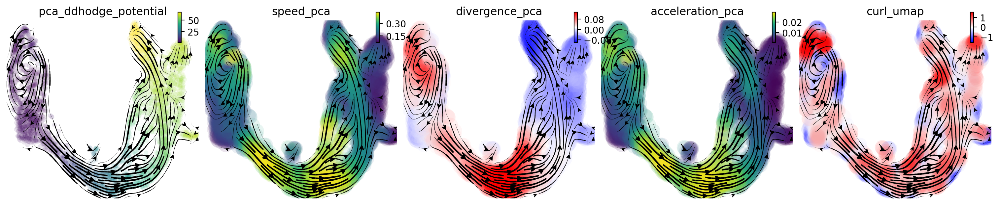

In [26]:
import matplotlib.pyplot as plt
fig1, f1_axes = plt.subplots(ncols=5, nrows=1, constrained_layout=True, figsize=(15, 3))
f1_axes
f1_axes[0] = dyn.pl.streamline_plot(adata, basis='umap', color='pca_ddhodge_potential', pointsize=0.1, alpha = 0.7, ax=f1_axes[0], quiver_length=6, 
                                    quiver_size=6, save_show_or_return='return', show_arrowed_spines=False)
f1_axes[1] = dyn.pl.streamline_plot(adata, basis='umap', color='speed_pca', ax=f1_axes[1], quiver_length=12, quiver_size=12, save_show_or_return='return', 
                                    show_arrowed_spines=False)
f1_axes[2] = dyn.pl.streamline_plot(adata, basis='umap', color='divergence_pca', ax=f1_axes[2], save_show_or_return='return',
                                   show_arrowed_spines=False, cmap='bwr', sym_c=True)
f1_axes[3] = dyn.pl.streamline_plot(adata, basis='umap', color='acceleration_pca', ax=f1_axes[3], save_show_or_return='return', 
                                    show_arrowed_spines=False)
f1_axes[4] = dyn.pl.streamline_plot(adata, basis='umap', color='curl_umap', ax=f1_axes[4], save_show_or_return='return', 
                                    show_arrowed_spines=False, cmap='bwr', sym_c=True)
plt.savefig(dpi=300, fname='./pancreas_vector_calculus.png')


In [27]:
example_genes = ['Cpe']
import numpy as np 

dyn.pl.scatters(adata, x=np.repeat('pca_ddhodge_potential', 1),
                     y=example_genes, layer='X_spliced', color='pca_ddhodge_potential', 
                     background='white', figsize=(3, 3), save_show_or_return='save',
                     pointsize=0.4, ncols=1, alpha = 0.7, 
                     save_kwargs={'prefix': 'pancreas_potential', 'ext': 'png', "bbox_inches": None})

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/pancreas_potential_dyn_savefig.png...
Done


<Figure size 300x300 with 0 Axes>

|-----> Downloading data to ./data/endocrinogenesis_day15.h5ad
|-----> apply Monocole recipe to adata...
|-----> <insert> pp to uns in AnnData Object.
|-----------> <insert> has_splicing to uns['pp'] in AnnData Object.
|-----------> <insert> has_labling to uns['pp'] in AnnData Object.
|-----------> <insert> splicing_labeling to uns['pp'] in AnnData Object.
|-----------> <insert> has_protein to uns['pp'] in AnnData Object.
|-----> ensure all cell and variable names unique.
|-----> ensure all data in different layers in csr sparse matrix format.
|-----> ensure all labeling data properly collapased
|-----------> <insert> tkey to uns['pp'] in AnnData Object.
|-----------> <insert> experiment_type to uns['pp'] in AnnData Object.
|-----> filtering cells...
|-----> filtering genes...
|-----> calculating size factor...
|-----> selecting genes...
|-----> <insert> frac to var in AnnData Object.
|-----> size factor normalizing the data, followed by log1p transformation.
|-----> applying PCA ...
|

<Figure size 600x400 with 0 Axes>

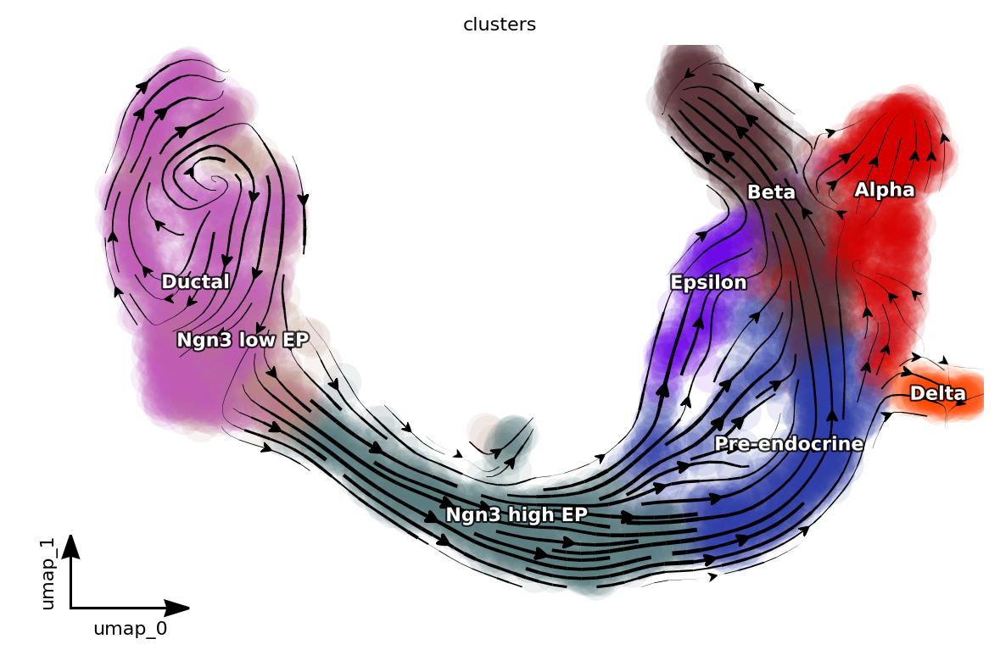

In [40]:
# # run dynamo determinstic 

# run dynamo to get RNA velocity 

dyn.configuration.set_figure_params('dynamo', background='white')

adata = dyn.sample_data.pancreatic_endocrinogenesis()

dyn.pp.recipe_monocle(adata, n_top_genes=2000, fg_kwargs={'shared_count': 20}, num_dim=30)

dyn.tl.dynamics(adata, model='stochastic')

dyn.tl.reduceDimension(adata, n_pca_components=30)

dyn.tl.cell_velocities(adata, method='pearson', other_kernels_dict={'transform': 'sqrt'}, enforce=True)
dyn.pl.streamline_plot(adata, color=['clusters'], basis='umap', show_legend='on data', show_arrowed_spines=True)


|-----> Downloading data to ./data/endocrinogenesis_day15.h5ad
|-----> apply Monocole recipe to adata...
|-----> <insert> pp to uns in AnnData Object.
|-----------> <insert> has_splicing to uns['pp'] in AnnData Object.
|-----------> <insert> has_labling to uns['pp'] in AnnData Object.
|-----------> <insert> splicing_labeling to uns['pp'] in AnnData Object.
|-----------> <insert> has_protein to uns['pp'] in AnnData Object.
|-----> ensure all cell and variable names unique.
|-----> ensure all data in different layers in csr sparse matrix format.
|-----> ensure all labeling data properly collapased
|-----------> <insert> tkey to uns['pp'] in AnnData Object.
|-----------> <insert> experiment_type to uns['pp'] in AnnData Object.
|-----> filtering cells...
|-----> filtering genes...
|-----> calculating size factor...
|-----> selecting genes...
|-----> <insert> frac to var in AnnData Object.
|-----> size factor normalizing the data, followed by log1p transformation.
|-----> applying PCA ...
|

<Figure size 600x400 with 0 Axes>

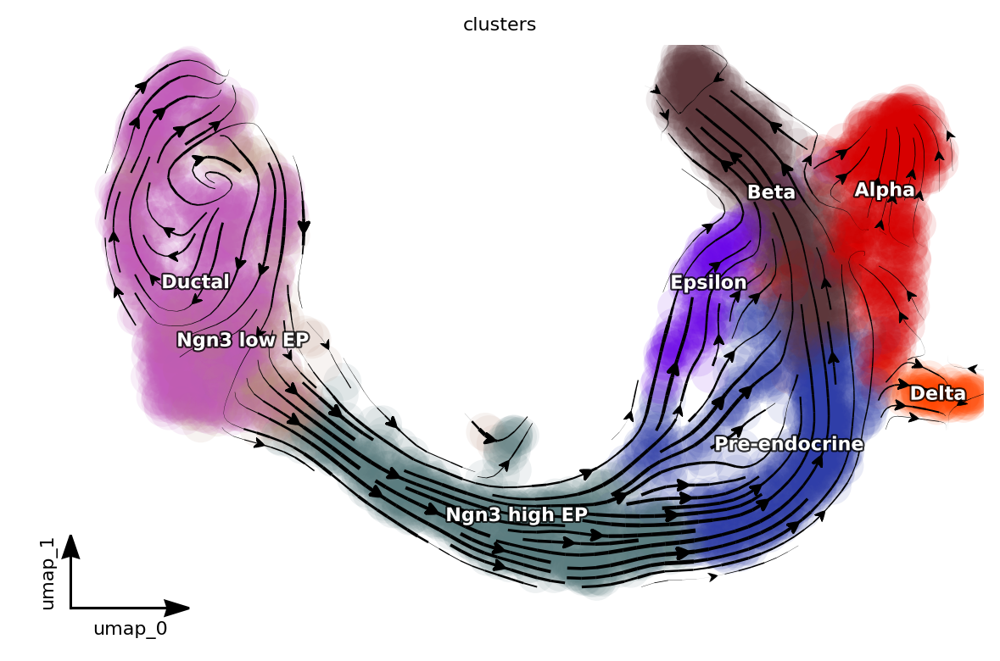

In [41]:
# # run dynamo determinstic 

# run dynamo to get RNA velocity 

dyn.configuration.set_figure_params('dynamo', background='white')

adata_det = dyn.sample_data.pancreatic_endocrinogenesis()

dyn.pp.recipe_monocle(adata_det, n_top_genes=2000, fg_kwargs={'shared_count': 20}, num_dim=30)

dyn.tl.dynamics(adata_det, model='deterministic')

dyn.tl.reduceDimension(adata_det, n_pca_components=30)

dyn.tl.cell_velocities(adata_det, method='pearson', other_kernels_dict={'transform': 'sqrt'}, enforce=True)
dyn.pl.streamline_plot(adata_det, color=['clusters'], basis='umap', show_legend='on data', show_arrowed_spines=True)


In [42]:
adata_det

AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'Size_Factor', 'initial_cell_size', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase'
    var: 'highly_variable_genes', 'nCells', 'nCounts', 'pass_basic_filter', 'log_m', 'log_cv', 'score', 'use_for_pca', 'frac', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca', 'pp', 'velocyto_SVR', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'pca_fit', 'feature_selection', 'cell_phase_genes', 'dynamics', 'grid_velocity_umap'
    obsm: 'X_pca', 'X_umap', 'X', 'cell_cycle_scores', 'velocity_umap'
    la

|-----> Downloading data to ./data/endocrinogenesis_day15.h5ad
|-----> apply Monocole recipe to adata...
|-----> <insert> pp to uns in AnnData Object.
|-----------> <insert> has_splicing to uns['pp'] in AnnData Object.
|-----------> <insert> has_labling to uns['pp'] in AnnData Object.
|-----------> <insert> splicing_labeling to uns['pp'] in AnnData Object.
|-----------> <insert> has_protein to uns['pp'] in AnnData Object.
|-----> ensure all cell and variable names unique.
|-----> ensure all data in different layers in csr sparse matrix format.
|-----> ensure all labeling data properly collapased
|-----------> <insert> tkey to uns['pp'] in AnnData Object.
|-----------> <insert> experiment_type to uns['pp'] in AnnData Object.
|-----> filtering cells...
|-----> filtering genes...
|-----> calculating size factor...
|-----> selecting genes...
|-----> <insert> frac to var in AnnData Object.
|-----> size factor normalizing the data, followed by log1p transformation.
|-----> applying PCA ...
|

<Figure size 600x400 with 0 Axes>

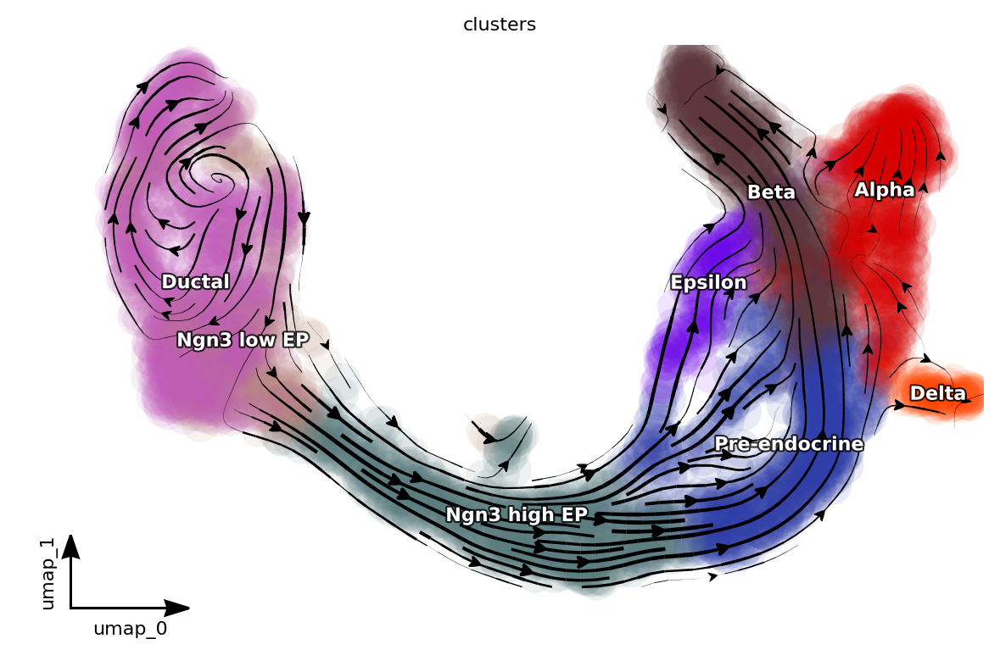

In [43]:
# run dynamo nb 


# run dynamo to get RNA velocity 

dyn.configuration.set_figure_params('dynamo', background='white')

adata_nb = dyn.sample_data.pancreatic_endocrinogenesis()

dyn.pp.recipe_monocle(adata_nb, n_top_genes=2000, fg_kwargs={'shared_count': 20}, num_dim=30)

dyn.tl.dynamics(adata_nb, est_method='negbin')

dyn.tl.reduceDimension(adata_nb, n_pca_components=30)

dyn.tl.cell_velocities(adata_nb, method='pearson', other_kernels_dict={'transform': 'sqrt'})
dyn.pl.streamline_plot(adata_nb, color=['clusters'], basis='umap', show_legend='on data', show_arrowed_spines=True)


In [44]:
adata.var.use_for_transition.sum(), adata_det.var.use_for_transition.sum(), adata_nb.var.use_for_transition.sum()

(1048, 1012, 1059)

In [45]:
dyn.cleanup(adata)
dyn.cleanup(adata_det)
dyn.cleanup(adata_nb)

AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'Size_Factor', 'initial_cell_size', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase'
    var: 'highly_variable_genes', 'nCells', 'nCounts', 'pass_basic_filter', 'log_m', 'log_cv', 'score', 'use_for_pca', 'frac', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca', 'pp', 'velocyto_SVR', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'pca_fit', 'feature_selection', 'cell_phase_genes', 'dynamics', 'grid_velocity_umap'
    obsm: 'X_pca', 'X_umap', 'X', 'cell_cycle_scores', 'velocity_umap'
    la

In [46]:
adata.write_h5ad('./data/pancreas_dynamo_stochastic.h5ad')
adata_det.write_h5ad('./data/pancreas_dynamo_det.h5ad')
adata_nb.write_h5ad('./data/pancreas_dynamo_nb.h5ad')

In [50]:
dyn.pl.streamline_plot(adata, color=['clusters'], basis='umap', show_legend='on data',  background='white',
                        show_arrowed_spines=False, save_show_or_return='save',
                        pointsize=0.4, ncols=1, alpha = 0.7, 
                       save_kwargs={'prefix': 'pancreas_stochastic', 'ext': 'svg',
                                     "bbox_inches": None}, 
                        figsize=(4, 3))

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/pancreas_stochastic_dyn_savefig.svg...
Done


<Figure size 400x300 with 0 Axes>

In [51]:
dyn.pl.streamline_plot(adata_det, color=['clusters'], basis='umap', show_legend='on data',  background='white',
                        show_arrowed_spines=False, save_show_or_return='save',
                        pointsize=0.4, ncols=1, alpha = 0.7, 
                       save_kwargs={'prefix': 'pancreas_det', 'ext': 'svg',
                                     "bbox_inches": None}, 
                        figsize=(4, 3))

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/pancreas_det_dyn_savefig.svg...
Done


<Figure size 400x300 with 0 Axes>

In [52]:
dyn.pl.streamline_plot(adata_nb, color=['clusters'], basis='umap', show_legend='on data',  background='white',
                        show_arrowed_spines=False, save_show_or_return='save',
                        pointsize=0.4, ncols=1, alpha = 0.7, 
                       save_kwargs={'prefix': 'pancreas_nb', 'ext': 'svg',
                                     "bbox_inches": None}, 
                        figsize=(4, 3))

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/pancreas_nb_dyn_savefig.svg...
Done


<Figure size 400x300 with 0 Axes>